# Perform maxstable PCA for the elbe dataset and evaluate if the fit generalitzes on a test dataset

In [99]:
library(data.table)
library(maxstablePCA)
library(GGally)
library(ggplot2)
library(dplyr)
library(ggmap)
library(sf)
library(lubridate)
library(osmdata)
library(ggspatial)
library(rnaturalearth)

Data (c) OpenStreetMap contributors, ODbL 1.0. https://www.openstreetmap.org/copyright



### General setup and declustering

In [2]:
set.seed(3107)

In [3]:
data(elbe)

In [4]:
train <- elbe$train$raw 
test <- elbe$test$raw

train$date <- as.Date(train$date)
test$date <- as.Date(test$date)

train_summer <-  train %>% filter(month(date) >= 6, month(date) <= 9)
test_summer <-  test%>% filter(month(date) >= 6, month(date) <= 9)

train_summer_declustered <- train_summer %>% 
group_by(year(date), month(date), day(date) > 15) %>% 
summarize_all(max) %>% 
na.omit()

test_summer_declustered <- test_summer %>% 
group_by(year(date), month(date), day(date) > 15) %>% 
summarize_all(max) %>% 
na.omit()

In [5]:
train_summer_declustered

year(date),month(date),day(date) > 15,date,Aken,Bad_Dueben,Calbe,Dresden,Havelberg_Stadt,Loeben,Magdeburg,Neu_Darchau,Schoena,Tangermuende,Torgau,Wittenberg,Wittenberge
<dbl>,<dbl>,<lgl>,<date>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<dbl>,<int>,<dbl>,<dbl>,<int>
1993,6,FALSE,1993-06-15,203,60.2,86.5,192,76.3,6.01,279,385,165,290,144,163,423
1993,6,TRUE,1993-06-30,222,36.2,67.2,170,111.0,4.22,283,426,159,296,164,178,433
1993,7,FALSE,1993-07-15,270,61.0,84.5,239,82.1,9.60,301,363,222,293,208,219,374
1993,7,TRUE,1993-07-31,291,65.0,70.8,247,96.7,13.50,331,479,215,357,218,231,471
1993,8,FALSE,1993-08-15,265,47.5,78.0,201,99.0,14.30,323,516,170,359,185,207,486
1993,8,TRUE,1993-08-31,179,18.2,58.5,132,77.2,8.92,252,408,102,279,122,133,400
1993,9,FALSE,1993-09-15,246,53.0,69.6,204,106.0,16.50,295,422,161,300,175,189,421
1993,9,TRUE,1993-09-30,248,31.0,69.0,186,111.0,16.50,305,462,158,314,167,199,450
1994,6,FALSE,1994-06-15,410,45.2,139.0,249,150.0,24.60,561,797,203,572,250,302,753


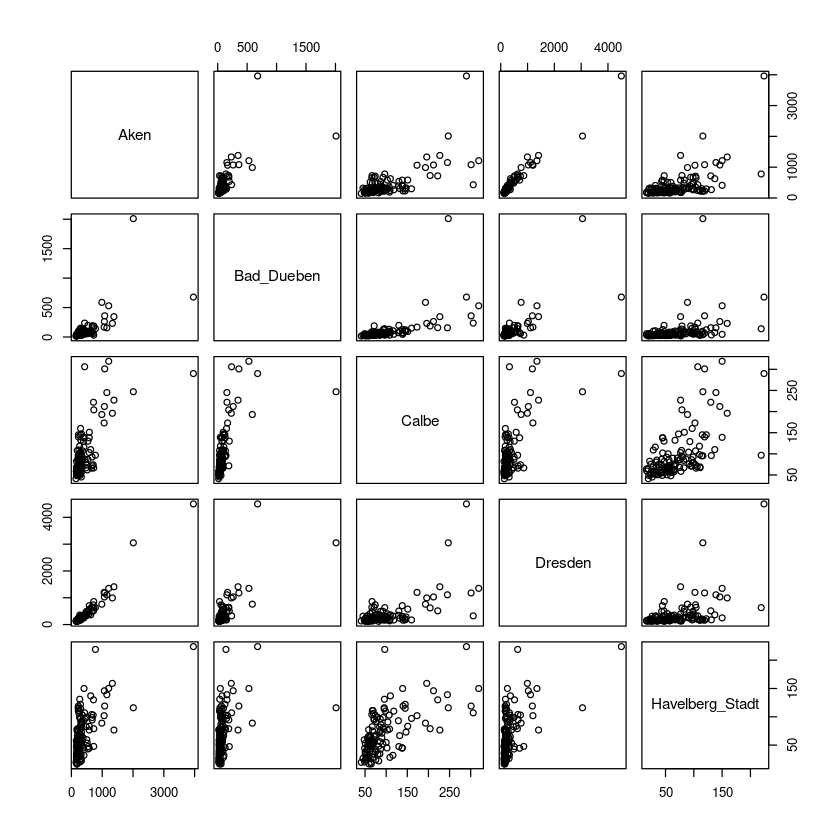

In [6]:
pairs(train_summer_declustered[, 5:9])

In [7]:
train_numeric <- transform_unitpareto(train_summer_declustered[, 5:17])

### Investigate how many exceedances there are and fitting max-stable PCA

In [8]:
quantile(apply(train_numeric, 1, sum), c(0.5, 0.75, 0.85, 0.9, 0.95, 0.99))

50%       75%       85%       90%       95%       99% 
 29.00602  49.86241  83.66239 119.44148 274.32143 556.29337

In [9]:
length(which(apply(train_numeric, 1, sum) > 100))

[1] 14

In [10]:
sl1 <- c(100)
nreps <- 1000

maxPCAlist <- list()
losslandscapedat <- data.frame(p = NA, s = NA, lossval = NA)

for(s in sl1) {
    for(p in 1:5) {
        for(i in 1:nreps) {
            if(i == 1) {
                maxPCAlist[[p]] <- max_stable_prcomp(train_numeric, p=p, s=s, n_initial_guesses = 1000, norm = "l1", optim_style = "alternating")
            } else {
                tmp <- max_stable_prcomp(train_numeric, p=p, s=s, n_initial_guesses = 1000, norm = "l1", optim_style = "alternating")
                if(tmp$loss_fctn_value < maxPCAlist[[p]]$loss_fctn_value) {
                    maxPCAlist[[p]] <- tmp
                }
            }
        }
        tmpdat <- data.frame(p = p, s = s, lossval = maxPCAlist[[p]]$loss_fctn_value)
        losslandscapedat <- full_join(losslandscapedat, tmpdat)
    }
}

losslandscapedat <- na.omit(losslandscapedat)

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using al

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using al

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using al

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using al

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using al

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using al

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using al

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using al

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using al

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using al

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using al

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using al

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using al

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using al

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using al

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using al

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using al

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using al

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using al

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using alternating optimization

Using al

### Investigate loss

In [11]:
losslandscapedat

,p,s,lossval
,<int>,<dbl>,<dbl>
2,1,100,4.405724
3,2,100,3.284815
4,3,100,2.392734
5,4,100,1.863507
6,5,100,1.346858


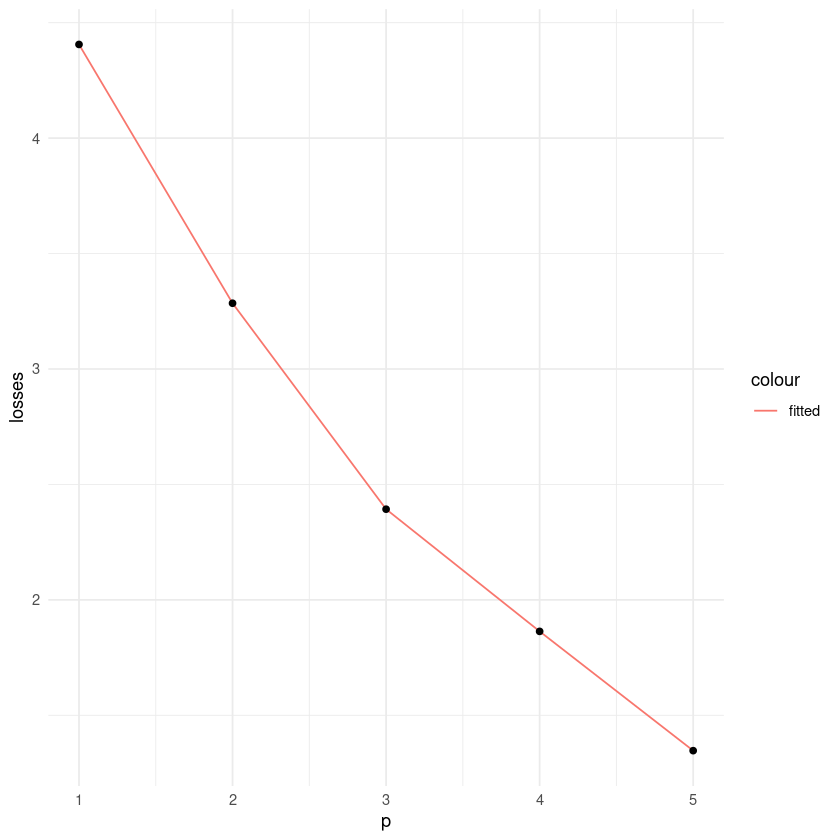

In [12]:
elbowplot_dat <- data.frame(p = 1:5)
losses <- c()
for(p in 1:5) losses[p] <- maxPCAlist[[p]]$loss_fctn_value
elbowplot_dat$losses <- losses

perror = ggplot(aes(x = p, y = losses), data = elbowplot_dat) + 
geom_line(aes(color = "fitted")) + 
geom_point() + 
#ylim(0,14) +
# geom_abline(slope = -1, intercept = 15) + 
theme_minimal()

perror

In [13]:
ggsave("elbow.png", perror)

Saving 7 x 7 in image


### Investigate fits

In [14]:
maxPCAlist[[1]]

$p
[1] 1

$d
[1] 13

$decoder_matrix
           [,1]
 [1,] 1.0000001
 [2,] 1.0714263
 [3,] 0.5384734
 [4,] 0.9999957
 [5,] 0.4983708
 [6,] 0.7272714
 [7,] 1.0000008
 [8,] 0.9967480
 [9,] 0.9999962
[10,] 1.0679157
[11,] 0.9999954
[12,] 1.0000000
[13,] 0.9677486

$encoder_matrix
          [,1]      [,2]       [,3]      [,4]       [,5]       [,6]      [,7]
[1,] 0.8026101 0.2666621 0.01541378 0.2017925 0.02219273 0.04940305 0.4612656
          [,8]      [,9]     [,10]     [,11] [,12]     [,13]
[1,] 0.1092684 0.4542763 0.3241595 0.8360553     1 0.0316704

$reconstr_matrix
           [,1]      [,2]        [,3]      [,4]       [,5]       [,6]      [,7]
 [1,] 0.8026102 0.2666621 0.015413787 0.2017925 0.02219273 0.04940305 0.4612657
 [2,] 0.8599376 0.2857087 0.016514734 0.2162058 0.02377787 0.05293172 0.4942121
 [3,] 0.4321842 0.1435904 0.008299912 0.1086599 0.01195019 0.02660222 0.2483792
 [4,] 0.8026067 0.2666609 0.015413718 0.2017917 0.02219263 0.04940283 0.4612636
 [5,] 0.3999974 0.1328966 

In [15]:
maxPCAlist[[2]]

$p
[1] 2

$d
[1] 13

$decoder_matrix
            [,1]      [,2]
 [1,] 0.13625516 1.0000006
 [2,] 0.42857807 0.5384615
 [3,] 1.00000370 0.3999976
 [4,] 0.05977958 0.9999994
 [5,] 0.25000170 0.2592627
 [6,] 1.00000592 0.1457908
 [7,] 0.04514402 1.0000023
 [8,] 0.15185206 1.0000017
 [9,] 0.11138392 0.9999978
[10,] 0.15410671 1.1818157
[11,] 0.14175996 0.9999975
[12,] 0.11014411 0.9999992
[13,] 0.15185206 0.9999977

$encoder_matrix
           [,1]       [,2]         [,3]      [,4]        [,5]      [,6]
[1,] 0.01601156 0.04732513 4.248618e-01 0.1466878 0.020938210 0.9999941
[2,] 0.19625646 0.04551788 7.923958e-05 0.4120836 0.005699229 0.1645305
          [,7]        [,8]      [,9]      [,10]      [,11]      [,12]
[1,] 0.1716998 0.007485743 0.1643790 0.04261897 0.03744338 0.05274392
[2,] 0.2605562 0.013736751 0.4213945 0.23027901 0.83333074 1.00000000
          [,13]
[1,] 0.10379277
[2,] 0.07189135

$reconstr_matrix
            [,1]       [,2]       [,3]      [,4]        [,5]      [,6]
 [1,]

In [16]:
maxPCAlist[[5]]

$p
[1] 5

$d
[1] 13

$decoder_matrix
            [,1]       [,2]        [,3]         [,4]         [,5]
 [1,] 1.00007042 0.23249300 0.004676587 0.0005098096 1.035640e-01
 [2,] 0.02334224 1.00001300 0.201862473 0.1964818350 9.735033e-02
 [3,] 0.18303776 0.10444422 1.000008813 0.0678419270 2.272326e-02
 [4,] 1.00006505 0.01554986 0.059206083 0.0009103776 1.542598e-19
 [5,] 0.11068756 0.05653628 0.001986178 0.2500006833 9.426777e-01
 [6,] 0.13419340 0.07514874 0.042007282 1.0000026047 4.588389e-02
 [7,] 1.00006844 0.13355049 0.076923757 0.0012707860 6.537900e-02
 [8,] 0.05292231 0.03637880 0.041598964 0.0009969279 1.027872e+00
 [9,] 1.00006349 0.08924639 0.045596552 0.0059747908 1.077056e-01
[10,] 1.00007048 0.13743390 0.056781612 0.2163320777 7.368243e-02
[11,] 1.00006262 0.10680621 0.004573919 0.0014213571 6.681738e-02
[12,] 1.00006725 0.10491613 0.052282057 0.1355939997 7.251457e-02
[13,] 0.22224035 0.03817876 0.020759872 0.0385516324 1.027869e+00

$encoder_matrix
           [,1]       

In [17]:
elbe$info

name,lat,lon,river,next_downstream
<chr>,<dbl>,<dbl>,<chr>,<chr>
Aken,51.8582,12.0522,Elbe,Magdeburg
Bad_Dueben,51.5906,12.5805,Mulde,Aken
Calbe,51.8958,11.7854,Saale,Magdeburg
Dresden,51.0559,13.7379,Elbe,Torgau
Havelberg_Stadt,52.8245,12.0804,Havel,Wittenberge
Loeben,51.7685,13.0827,schwarze Elster,Wittenberg
Magdeburg,52.1515,11.6700,Elbe,Tangermuende
Neu_Darchau,53.2347,10.8933,Elbe,
Schoena,50.8951,14.2245,Elbe,Dresden


In [18]:
test_trafo <- transform_unitpareto(test_summer_declustered[, 5:17])

In [19]:
rec_test <- data.frame(reconstruct(maxPCAlist[[5]], test_trafo))
names(rec_test) <- names(test_summer_declustered[,5:17])

In [20]:
testplotdat <- full_join(as.data.frame(test_trafo), rec_test)
testplotdat$is_rec <- c(rep(FALSE, dim(test_summer_declustered)[1]), rep(TRUE, dim(test_summer_declustered)[1]))

Joining with `by = join_by(Aken, Bad_Dueben, Calbe, Dresden, Havelberg_Stadt, Loeben, Magdeburg,
Neu_Darchau, Schoena, Tangermuende, Torgau, Wittenberg, Wittenberge)`


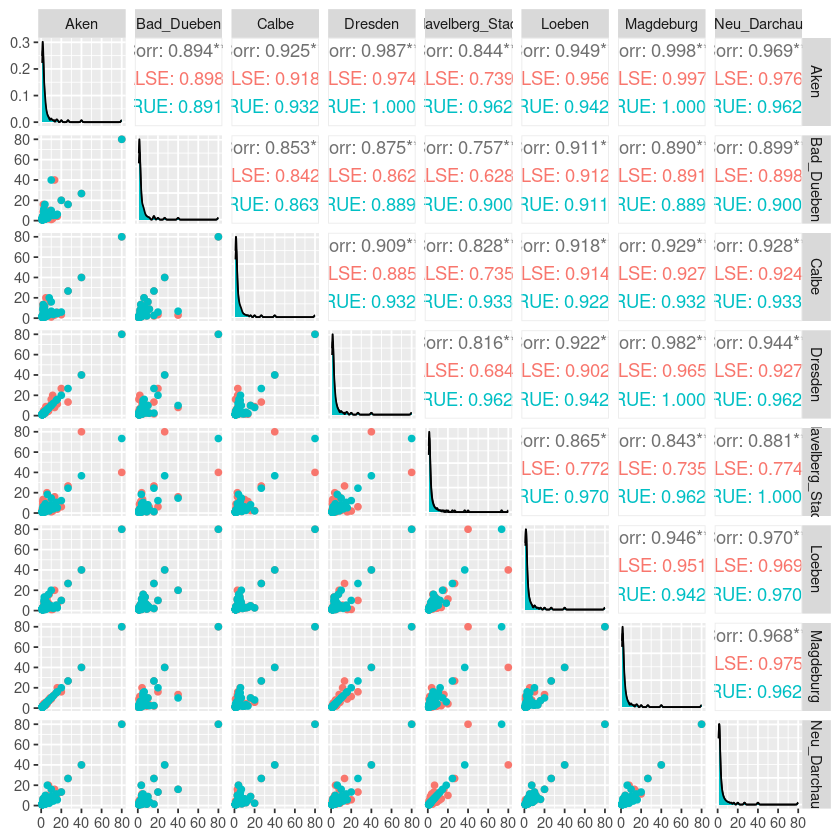

In [21]:
library(GGally)
ggpairs(testplotdat, columns = 1:8, aes(color = is_rec))

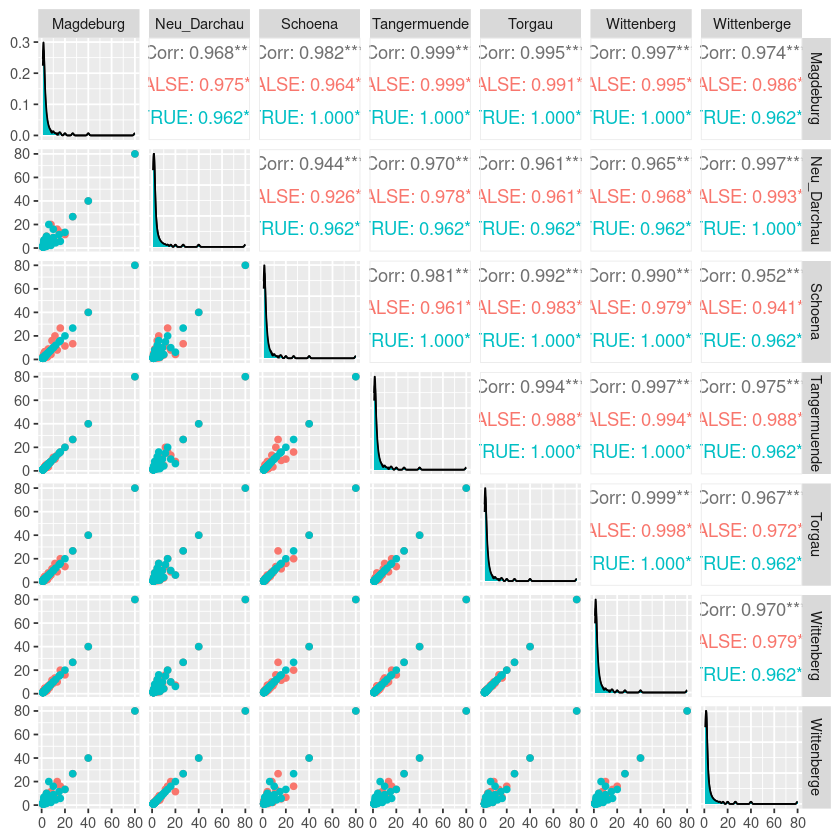

In [22]:
ggpairs(testplotdat, columns = 7:13, aes(color = is_rec))

In [142]:
sf_basin <- read_sf("./data/geoinfo_rivernetwork/mrb_basins.json")
sf_river <- read_sf("./data/geoinfo_rivernetwork/mrb_rivers.json")
sf_river2 <- read_sf("./data/geoinfo_rivernetwork/mrb_rivnets_Q08_09.json")
sf_river3 <- read_sf("./data/geoinfo_rivernetwork/mrb_rivnets_Q09_10.json")

rivercolor = "#3DE6FF"


station_info <- elbe$info

spatial_B_plot <- function(maxPCA, info, p) {
    value <- maxPCA$decoder_matrix[,p]

    plotdat <- data.frame(
        lat = info$lat, 
        lon = info$lon, 
        value = value
    )
    
    cities_sf <- st_as_sf(plotdat, coords = c("lon", "lat"), crs = 4326)
    
p <- ggplot() +
annotation_map_tile(type = "osm", zoom = 7) +   # OSM basemap
geom_sf(data = sf_river, fill = "#69b3a2", color = rivercolor, inherit.aes = F) +
geom_sf(data = sf_river2, fill = "#69b3a2", color = rivercolor, inherit.aes = F) +
geom_sf(data = sf_river3, fill = "#69b3a2", color = rivercolor, inherit.aes = F) +
geom_sf(data = cities_sf, aes(color = value), size = 7) +   # points
theme_void()


    return(p)
}

spatial_W_plot <- function(maxPCA, info, p) {
    value <- maxPCA$encoder_matrix[p,]

    plotdat <- data.frame(
        lat = info$lat, 
        lon = info$lon, 
        value = value
    )
    
cities_sf <- st_as_sf(plotdat, coords = c("lon", "lat"), crs = 4326)

p <- ggplot() +
annotation_map_tile(type = "osm", zoom = 7) +   # OSM basemap
geom_sf(data = sf_river, fill = "#69b3a2", color = rivercolor, inherit.aes = F) +
geom_sf(data = sf_river2, fill = "#69b3a2", color = rivercolor, inherit.aes = F) +
geom_sf(data = sf_river3, fill = "#69b3a2", color = rivercolor, inherit.aes = F) +
geom_sf(data = cities_sf, aes(color = value), size = 7) +   # points
theme_void()


    return(p)
}

# p = 1 analysis 

### W encoding

In [143]:
info <- elbe$info

Zoom: 7



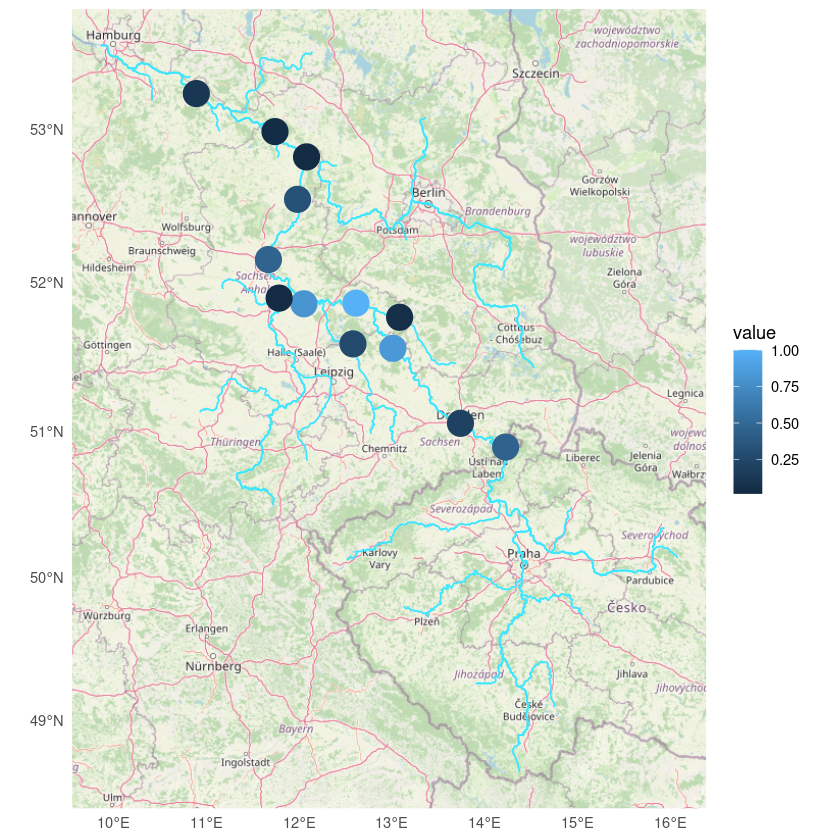

In [144]:
pp1w <- spatial_W_plot(maxPCAlist[[1]], info, 1) + theme_minimal()

pp1w

In [145]:
ggsave("pp1w.png", pp1w + theme_minimal())

Saving 7 x 7 in image
Zoom: 7



Zoom: 7



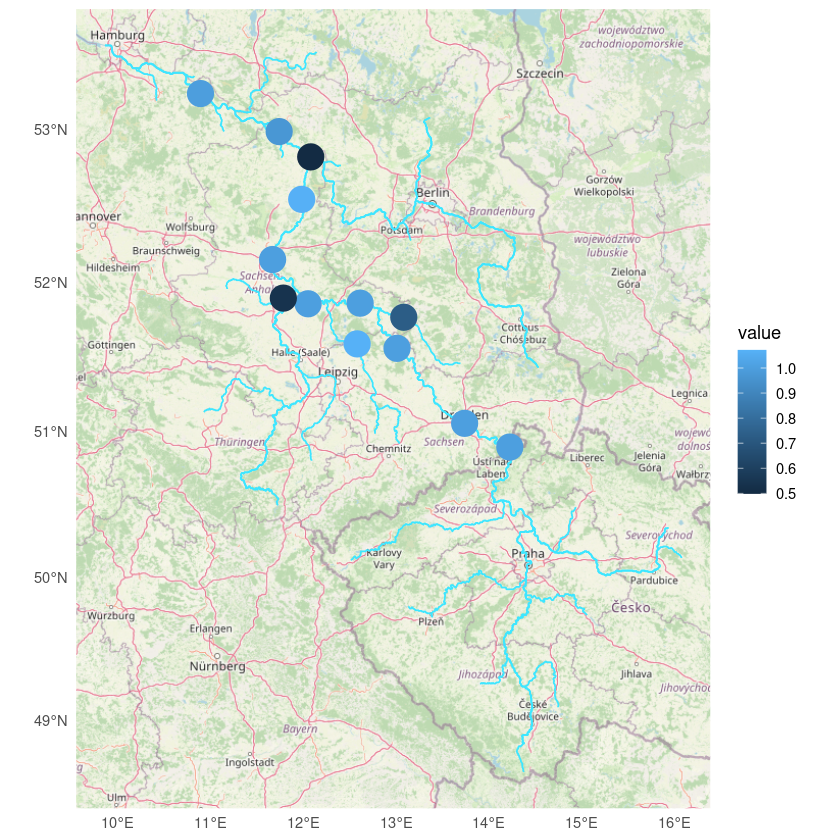

In [146]:
pp1b <- spatial_B_plot(maxPCAlist[[1]], info, 1) + theme_minimal()

pp1b

In [147]:
ggsave("pp1b.png", pp1b + theme_minimal())

Saving 7 x 7 in image
Zoom: 7



# p = 2 analysis 

### W encodings

Zoom: 7



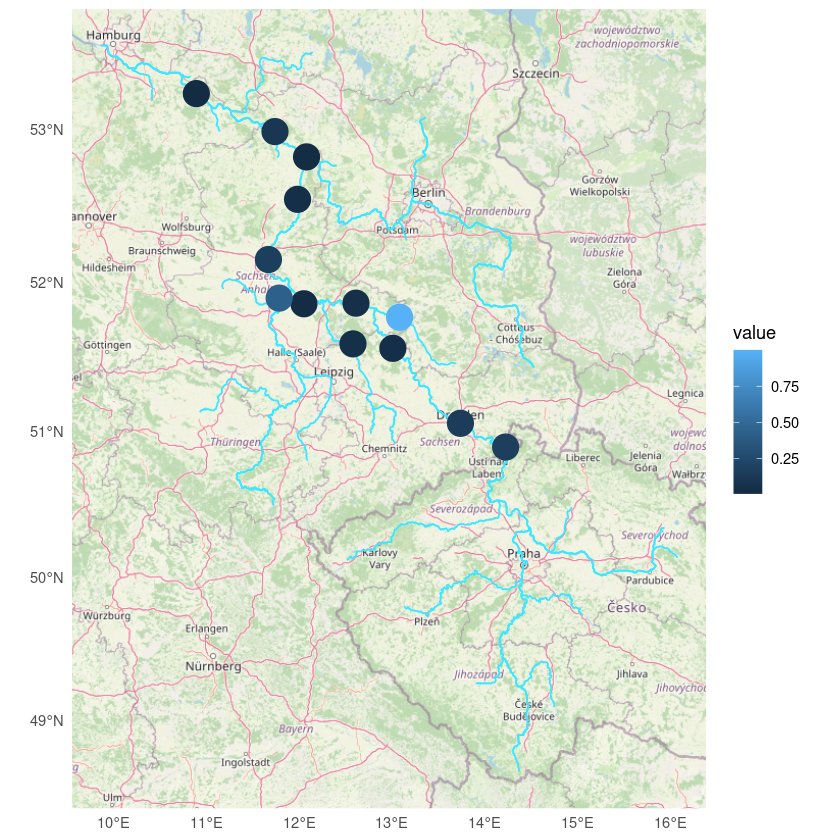

In [148]:
pp2w1 <- spatial_W_plot(maxPCAlist[[2]], info, 1) + theme_minimal()

pp2w1

Zoom: 7



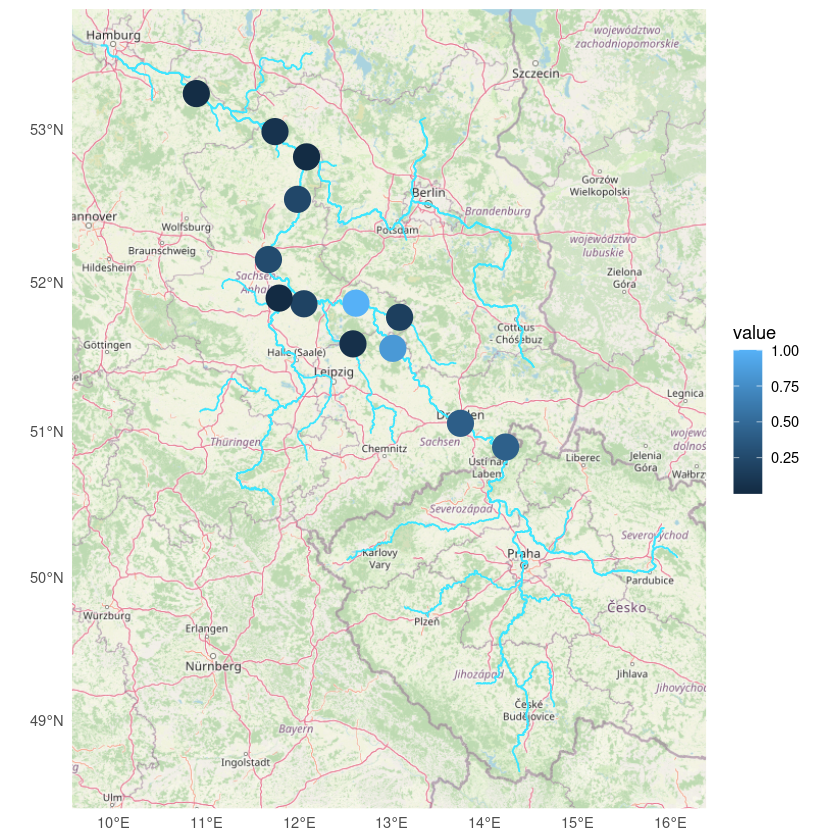

In [149]:
pp2w2 <- spatial_W_plot(maxPCAlist[[2]], info, 2) + theme_minimal()

pp2w2

### B columns for prototypical events

Zoom: 7



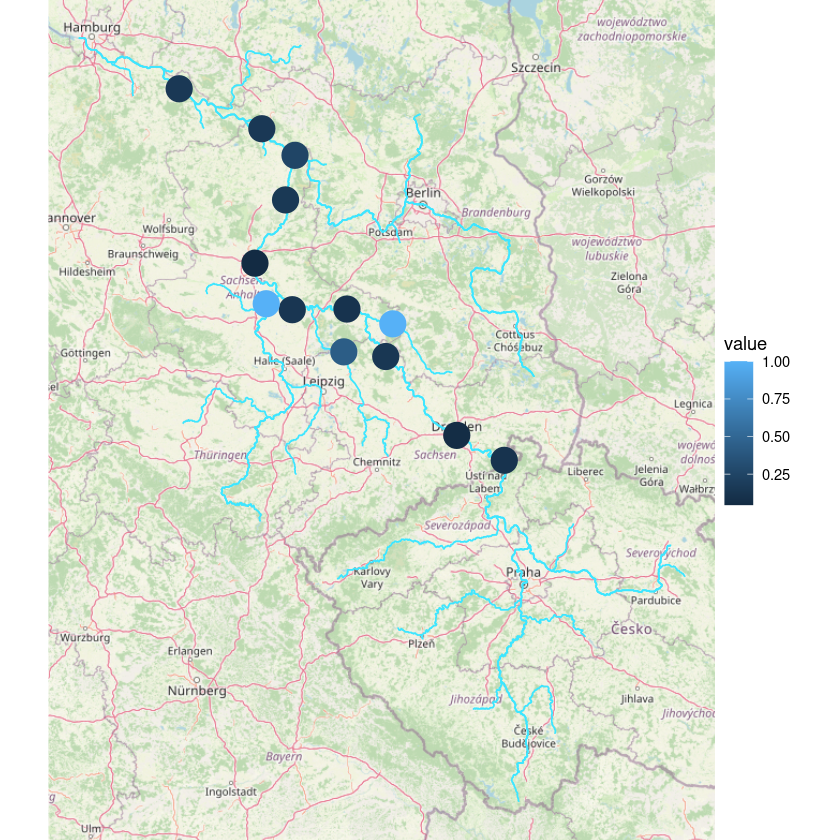

In [150]:
pp2B1 <- spatial_B_plot(maxPCAlist[[2]], info, 1)

pp2B1

Zoom: 7



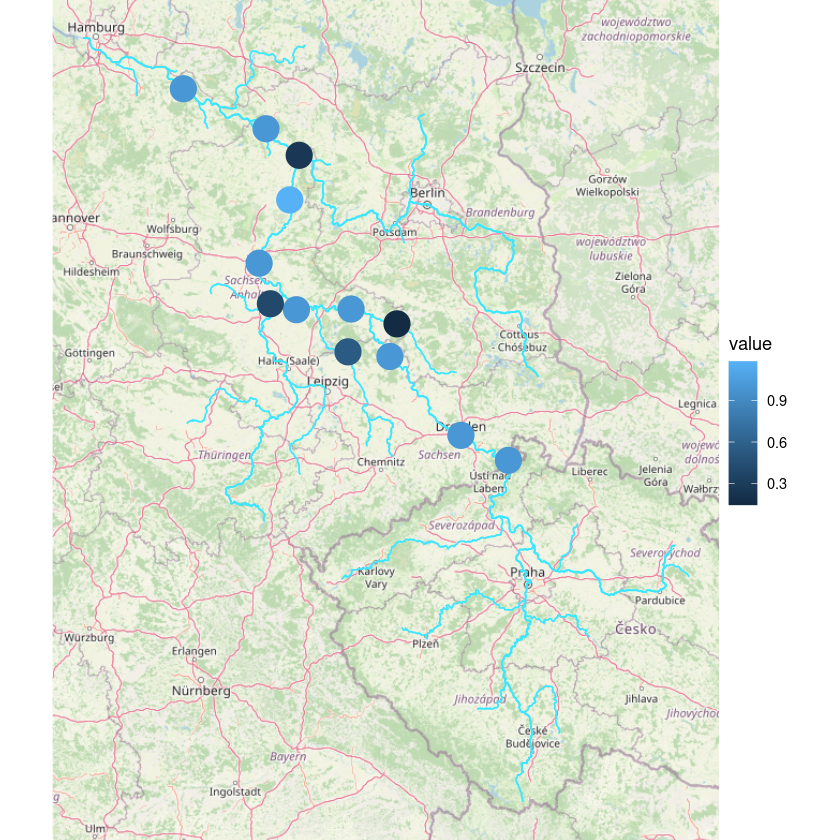

In [151]:
pp2B2 <- spatial_B_plot(maxPCAlist[[2]], info, 2)

pp2B2

In [152]:
ggsave("p2W1.png", pp2w1 + theme_minimal())
ggsave("p2W2.png", pp2w2 + theme_minimal())
ggsave("p2B1.png", pp2B1 + theme_minimal())
ggsave("p2B2.png", pp2B2 + theme_minimal())

Saving 7 x 7 in image
Zoom: 7

Saving 7 x 7 in image
Zoom: 7

Saving 7 x 7 in image
Zoom: 7

Saving 7 x 7 in image
Zoom: 7



# p = 5 analysis

There are $5$ distinct riverarms, so we analyze for this case as well. 

In [153]:
table(info$river)


           Elbe           Havel           Mulde           Saale schwarze Elster 
              9               1               1               1               1 

### W encodings 

Zoom: 7



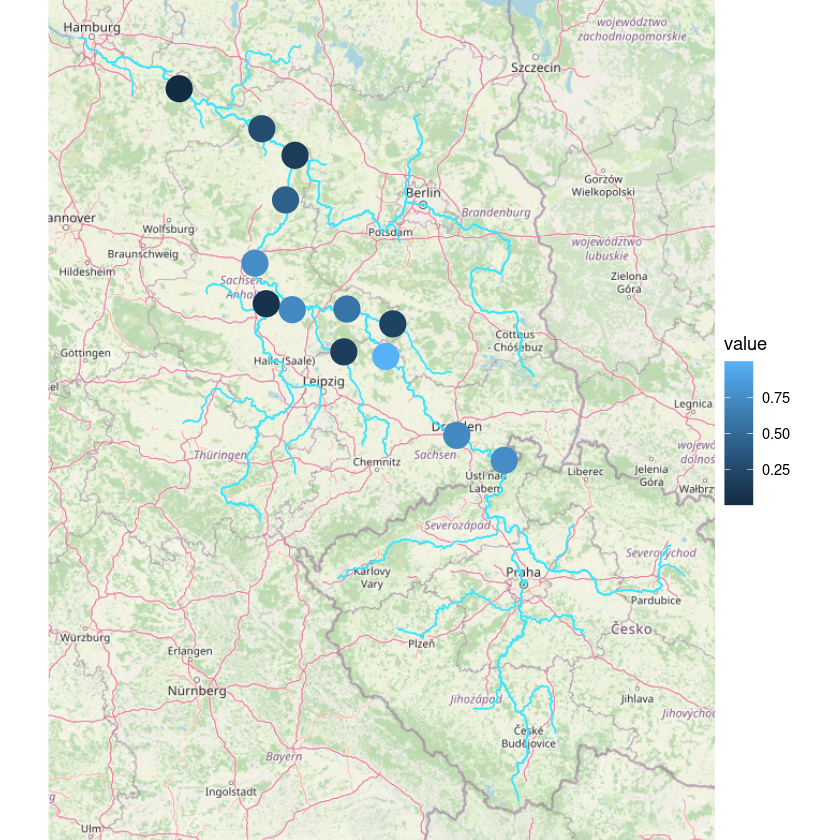

In [154]:
p5w1 <- spatial_W_plot(maxPCAlist[[5]], info, 1)
p5w1

Zoom: 7



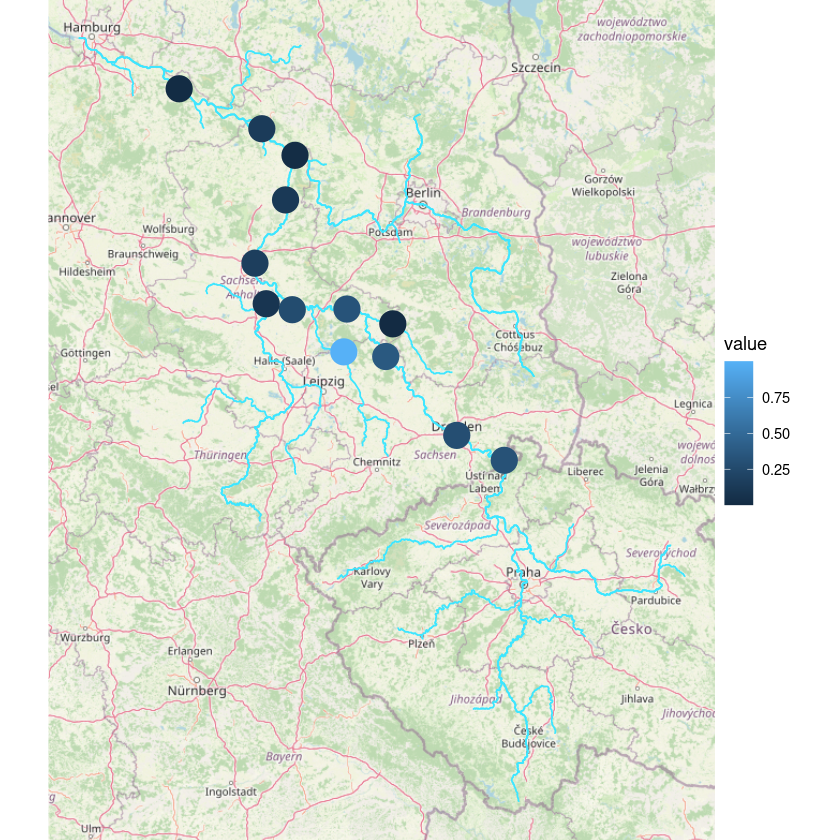

In [155]:
p5w2 <- spatial_W_plot(maxPCAlist[[5]], info, 2)
p5w2

Zoom: 7



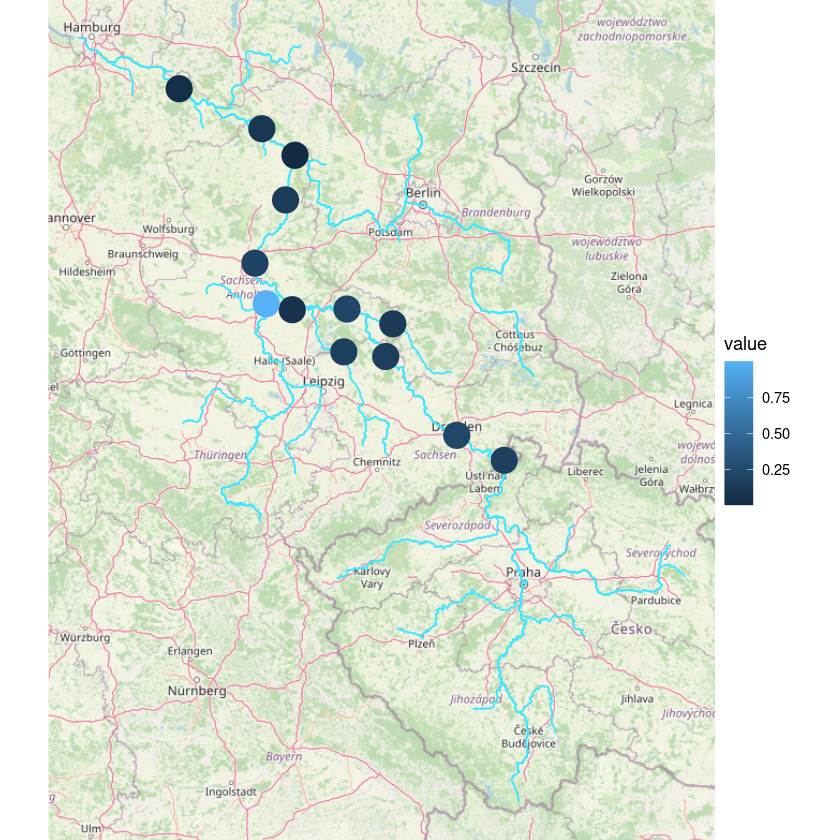

In [156]:
p5w3 <- spatial_W_plot(maxPCAlist[[5]], info, 3)
p5w3

Zoom: 7



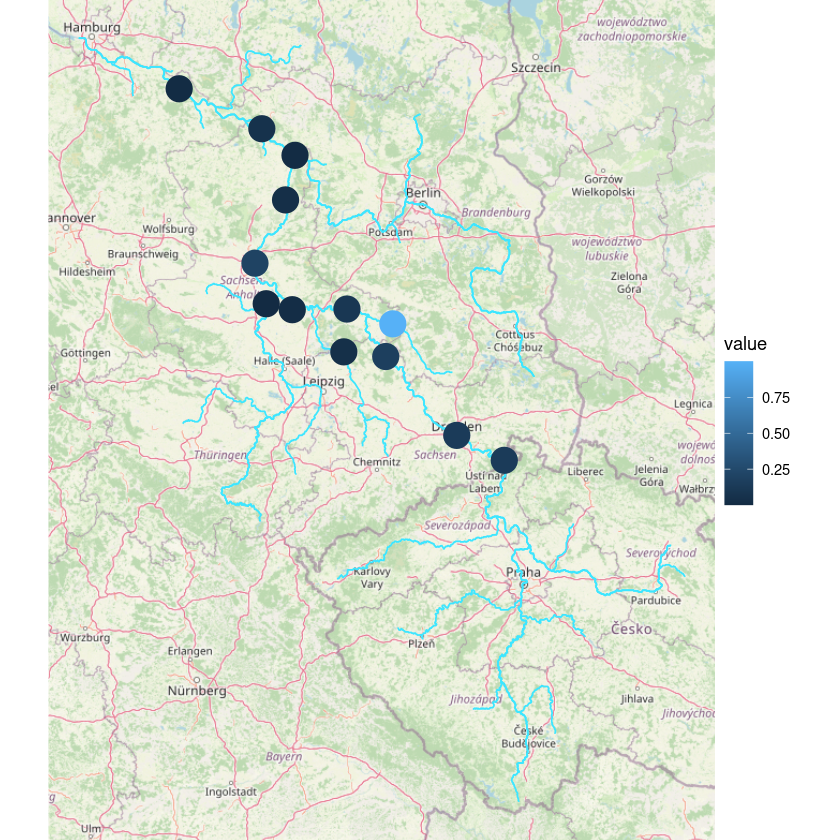

In [157]:
p5w4 <- spatial_W_plot(maxPCAlist[[5]], info, 4)
p5w4

Zoom: 7



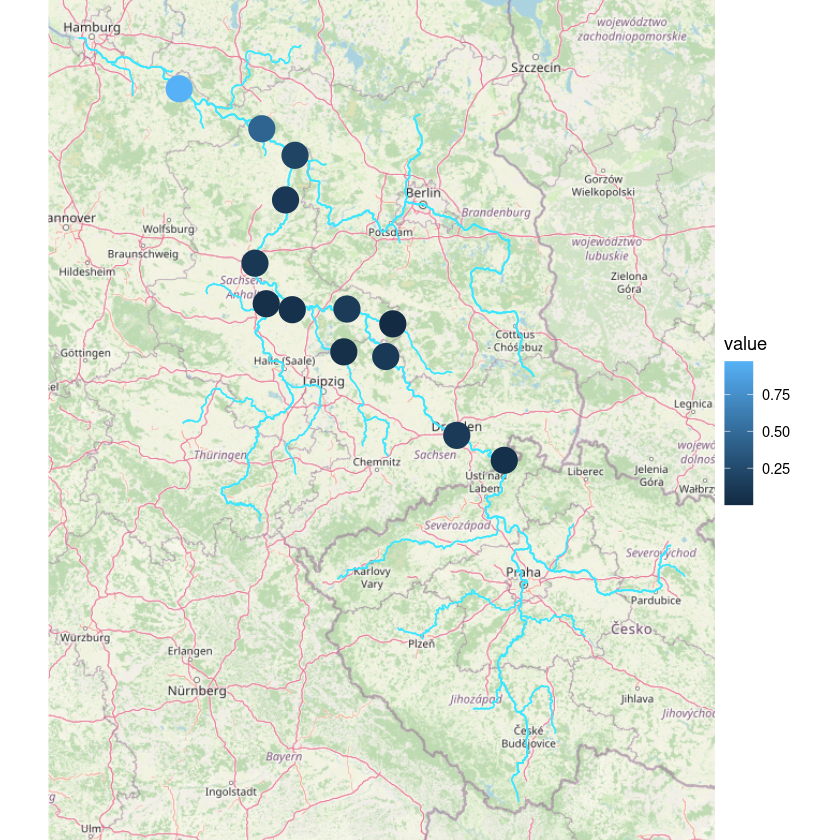

In [158]:
p5w5 <- spatial_W_plot(maxPCAlist[[5]], info, 5)
p5w5

plot encoded data

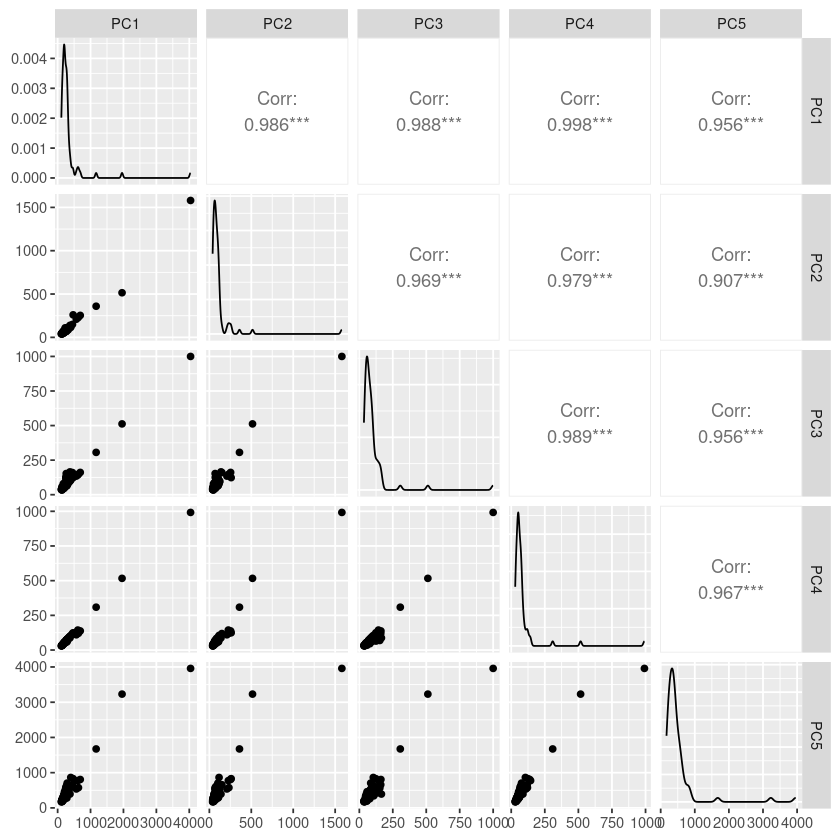

In [159]:
enc2 <- data.frame(compress(maxPCAlist[[5]], test_summer_declustered[, 5:17])) 
names(enc2) <- c("PC1", "PC2", "PC3", "PC4", "PC5")

ggpairs(enc2)

### B columns plotted 

Zoom: 7



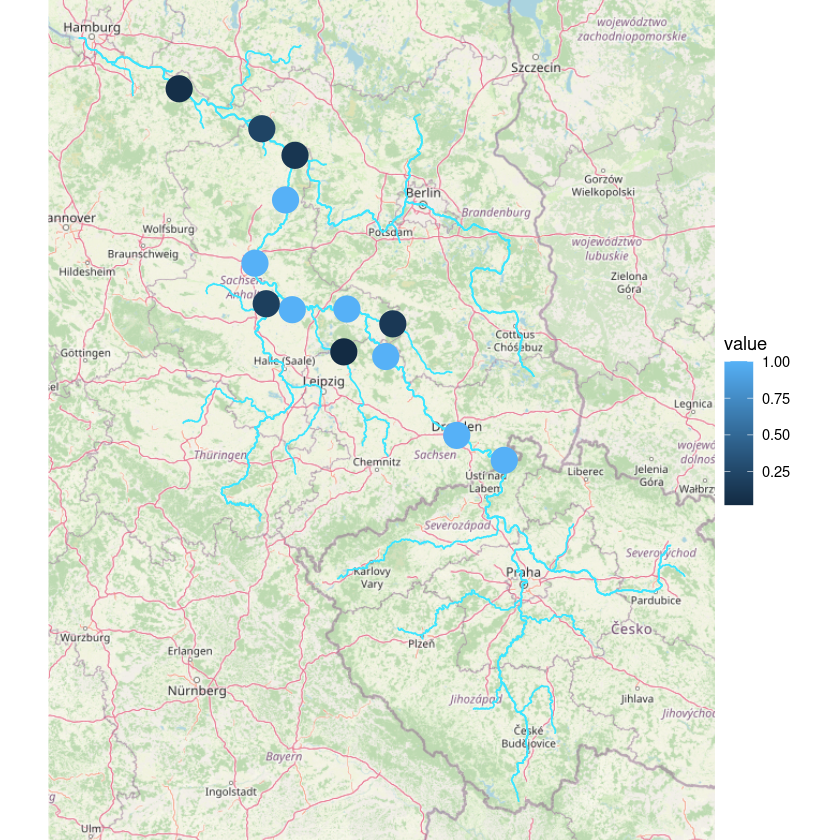

In [160]:
p5b1 <- spatial_B_plot(maxPCAlist[[5]], info, 1)
p5b1

Zoom: 7



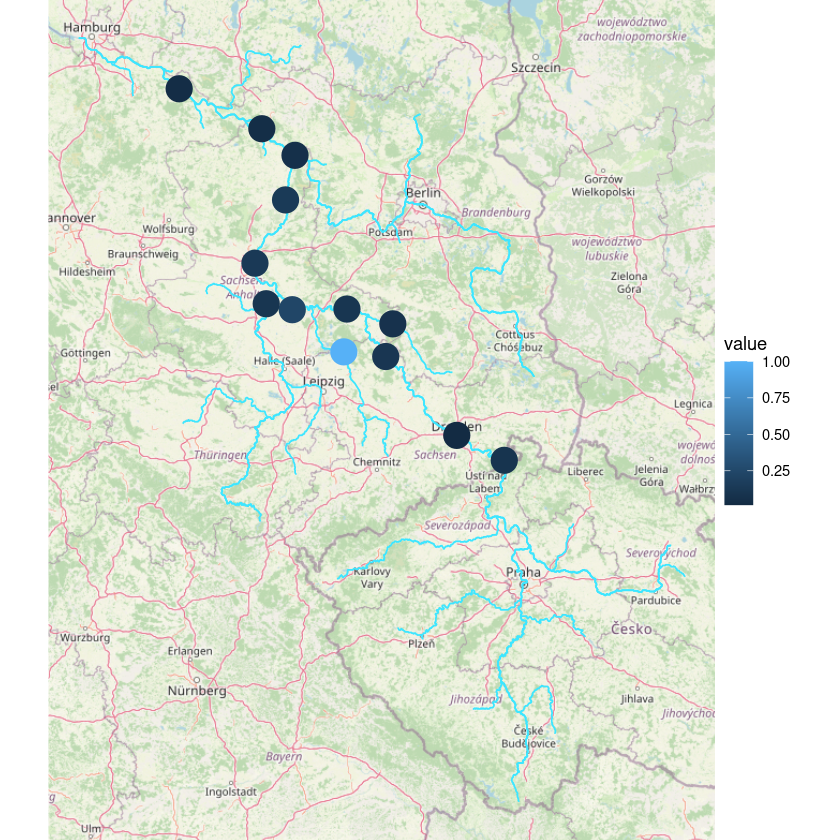

In [161]:
p5b2 <- spatial_B_plot(maxPCAlist[[5]], info, 2)
p5b2

Zoom: 7



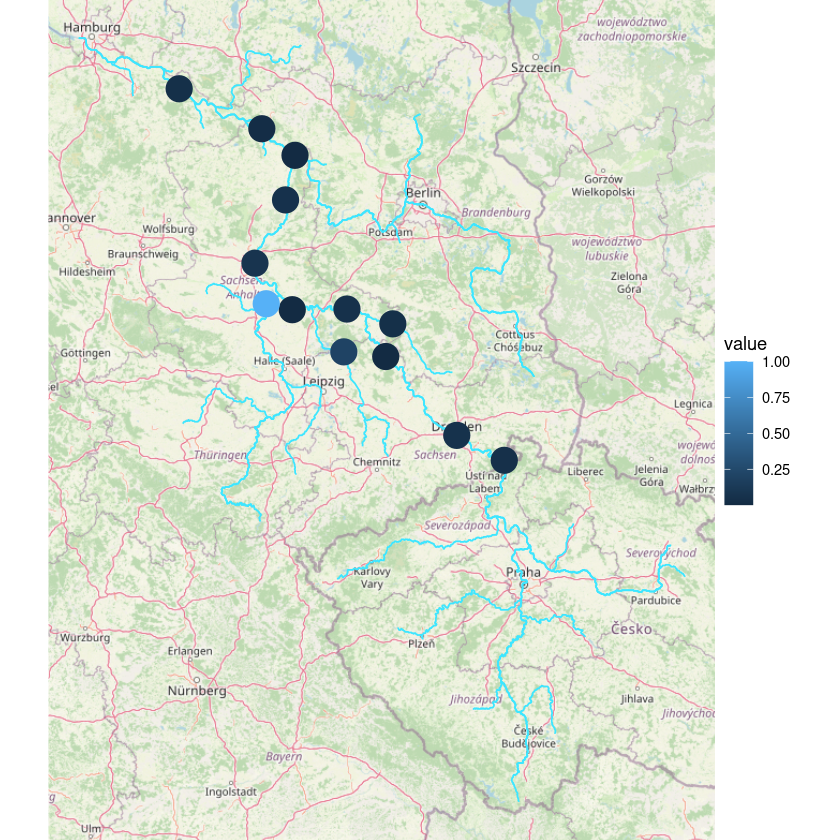

In [162]:
p5b3 <- spatial_B_plot(maxPCAlist[[5]], info, 3)
p5b3

Zoom: 7



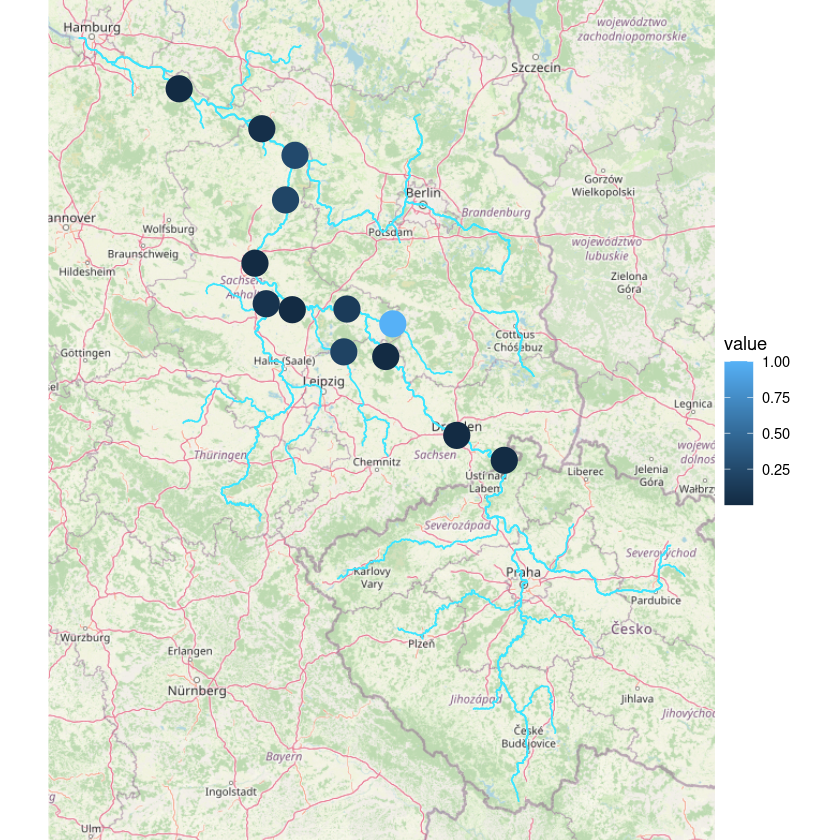

In [163]:
p5b4 <- spatial_B_plot(maxPCAlist[[5]], info, 4)
p5b4

Zoom: 7



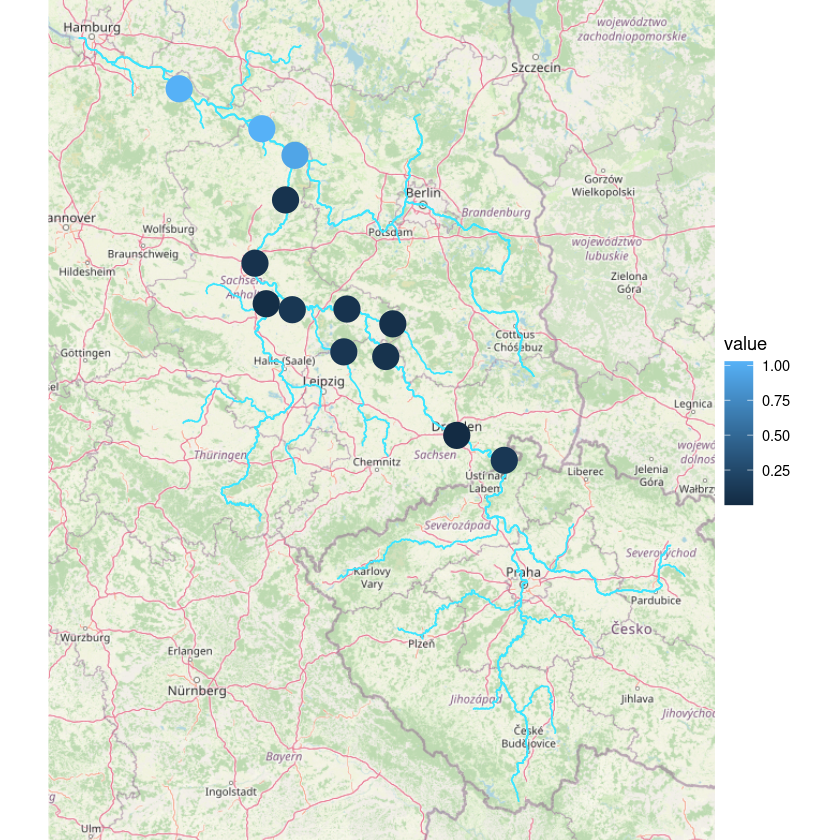

In [164]:
p5b5 <- spatial_B_plot(maxPCAlist[[5]], info, 5)
p5b5

In [165]:
ggsave("p5w1.png", p5w1)
ggsave("p5w2.png", p5w2)
ggsave("p5w3.png", p5w3)
ggsave("p5w4.png", p5w4)
ggsave("p5w5.png", p5w5)
ggsave("p5b1.png", p5b1)
ggsave("p5b2.png", p5b2)
ggsave("p5b3.png", p5b3)
ggsave("p5b4.png", p5b4)
ggsave("p5b5.png", p5b5)

Saving 7 x 7 in image
Zoom: 7

Saving 7 x 7 in image
Zoom: 7

Saving 7 x 7 in image
Zoom: 7

Saving 7 x 7 in image
Zoom: 7

Saving 7 x 7 in image
Zoom: 7

Saving 7 x 7 in image
Zoom: 7

Saving 7 x 7 in image
Zoom: 7

Saving 7 x 7 in image
Zoom: 7

Saving 7 x 7 in image
Zoom: 7

Saving 7 x 7 in image
Zoom: 7



In [166]:
names(train)

[1] "date"            "Aken"            "Bad_Dueben"      "Calbe"          
 [5] "Dresden"         "Havelberg_Stadt" "Loeben"          "Magdeburg"      
 [9] "Neu_Darchau"     "Schoena"         "Tangermuende"    "Torgau"         
[13] "Wittenberg"      "Wittenberge"

In [167]:
rec <- t(maxmatmul(maxPCAlist[[5]]$reconstr_matrix, t(train_summer_declustered[, 5:17])))
rec <- data.frame(rec)
names(rec) <- names(train_summer_declustered)[5:17]

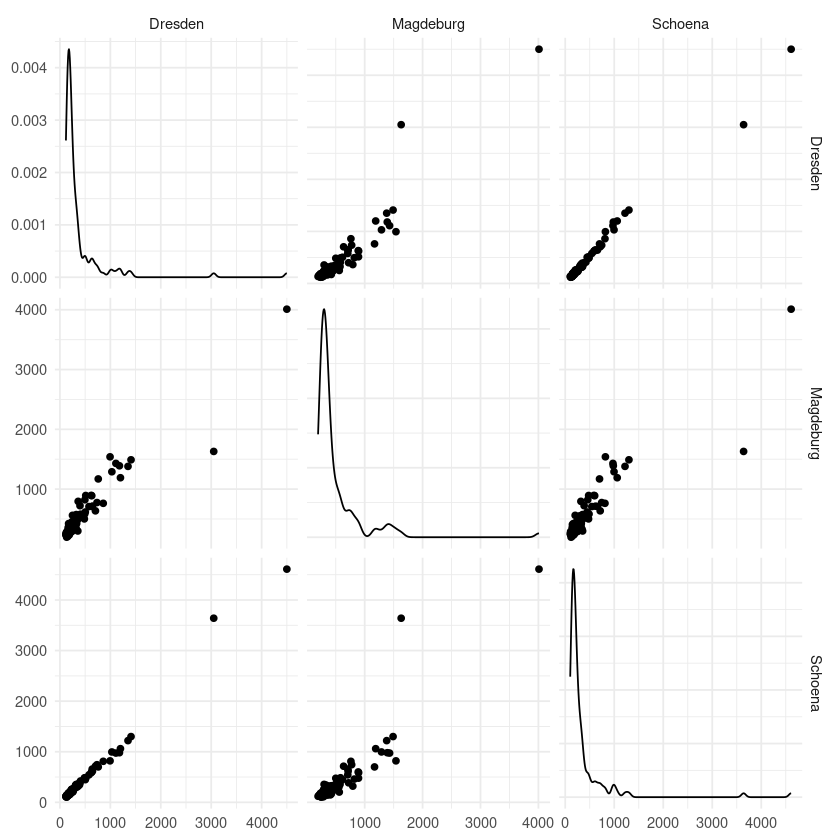

In [168]:
ppp <- ggpairs(columns = c(8, 11, 13), 
        data = train_summer_declustered, 
        # diag = list(continuous = "nadiag"), 
        upper =  list(continuous = "points")
) + theme_minimal()

ppp

# Estimating probabilities using values for the original margins

In [169]:
summary(train_summer_declustered$Schoena)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
  102.0   153.8   208.5   364.5   331.2  4610.0 

In [170]:
summary(train_summer_declustered$Dresden)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
  119.0   170.0   216.0   375.9   339.5  4500.0 

In [171]:
summary(train_summer_declustered$Magdeburg)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
  195.0   280.5   334.5   491.9   513.2  4010.0 

In [172]:
estprob_DDMD_high_Schoenaexc <- function(level_schoena, level_dd, level_md, p, s) {
    
    rectrain <- t(maxmatmul(maxPCAlist[[p]]$reconstr_matrix, t(train_numeric)))
    sphererectrain <- t(apply(rectrain, 1, function(z) z / sum(z)))
    sphererectrain <- sphererectrain[which(apply(rectrain, 1, sum) > s), ]

    sum(apply(
        sphererectrain,
        1,
        function(z) {
            unnormed <- min(
                c(
                    z[4] / (1 / (1 - ecdf(train_summer_declustered$Dresden)(level_dd))),
                    z[7] / (1 / (1 - ecdf(train_summer_declustered$Magdeburg)(level_md))),
                    z[9] / (1 / (1 - ecdf(train_summer_declustered$Schoena)(level_schoena)))
                )
                )
            return(
                unnormed / sum(sphererectrain[, 9] / (1 / (1 - ecdf(train_summer_declustered$Schoena)(level_schoena))))
            )
        }
    )
    )
}

In [173]:
estprob_DDMD_high_Schoenaexc_sm <- function(level_schoena, level_dd, level_md, s) {
    
    rectrain <- transform_unitfrechet(train_summer_declustered[, 5:17])
    sphererectrain <- t(apply(rectrain, 1, function(z) z / sum(z)))
    sphererectrain <- sphererectrain[which(apply(rectrain, 1, sum) > s), ]

    sum(apply(
        sphererectrain,
        1,
        function(z) {
            unnormed <- min(
                c(
                    z[4] / (1 / (1 - ecdf(train_summer_declustered$Dresden)(level_dd))),
                    z[7] / (1 / (1 - ecdf(train_summer_declustered$Magdeburg)(level_md))),
                    z[9] / (1 / (1 - ecdf(train_summer_declustered$Schoena)(level_schoena)))
                )
                )
            return(
                unnormed / sum(sphererectrain[, 9] / (1 / (1 - ecdf(train_summer_declustered$Schoena)(level_schoena))))
            )
        }
    )
    )
}

In [174]:
prob_DDMD_high <- function(level_schoena, level_dd, level_md) {
    val1 <- test_summer_declustered %>% filter(Schoena > level_schoena, Dresden > level_dd, Magdeburg > level_md) %>% NROW()
    val2 <- test_summer_declustered %>% filter(Schoena > level_schoena) %>% NROW()
    return(val1 / val2)
}

In [175]:
prob_DDMD_high_train <- function(level_schoena, level_dd, level_md) {
    val1 <- train_summer_declustered %>% filter(Schoena > level_schoena, Dresden > level_dd, Magdeburg > level_md) %>% NROW()
    val2 <- train_summer_declustered %>% filter(Schoena > level_schoena) %>% NROW()
    return(val1 / val2)
}

In [254]:
sest <- 100
pest <- 5
level_schoena <- 600
level_high <- 1000
level_low <- 700

In [255]:
summary(test_summer_declustered %>% select(Schoena, Dresden, Magdeburg))

Adding missing grouping variables: `year(date)`, `month(date)`


   year(date)    month(date)      Schoena          Dresden      
 Min.   :2011   Min.   :6.00   Min.   :  89.7   Min.   :  95.8  
 1st Qu.:2013   1st Qu.:6.75   1st Qu.: 135.8   1st Qu.: 142.5  
 Median :2016   Median :7.50   Median : 197.0   Median : 197.0  
 Mean   :2016   Mean   :7.50   Mean   : 278.8   Mean   : 288.2  
 3rd Qu.:2018   3rd Qu.:8.25   3rd Qu.: 259.0   3rd Qu.: 273.8  
 Max.   :2020   Max.   :9.00   Max.   :3710.0   Max.   :3910.0  
   Magdeburg     
 Min.   : 150.0  
 1st Qu.: 242.0  
 Median : 297.0  
 Mean   : 422.4  
 3rd Qu.: 386.2  
 Max.   :5010.0  

### See how many exceedances are in test and train dataset

In [256]:
dim(train_summer_declustered %>% filter(Schoena > level_schoena))

[1] 16 17

In [257]:
dim(train_summer_declustered %>% filter(Schoena > level_schoena, Dresden > level_high, Magdeburg > level_high))

[1]  8 17

In [258]:
dim(train_summer_declustered %>% filter(Schoena > level_schoena, Dresden > level_low, Magdeburg > level_high))

[1] 10 17

In [259]:
dim(train_summer_declustered %>% filter(Schoena > level_schoena, Dresden > level_high, Magdeburg > level_low))

[1]  8 17

In [260]:
dim(test_summer_declustered %>% filter(Schoena > level_schoena))

[1]  4 17

In [261]:
dim(test_summer_declustered %>% filter(Schoena > level_schoena, Dresden > level_high, Magdeburg > level_high))

[1]  2 17

In [262]:
dim(test_summer_declustered %>% filter(Schoena > level_schoena, Dresden > level_low, Magdeburg > level_high))

[1]  2 17

In [263]:
dim(test_summer_declustered %>% filter(Schoena > level_schoena, Dresden > level_high, Magdeburg > level_low))

[1]  2 17

# Estimate the probability that given the an exceedance in the most upstream station, the cities have a much higher flooding event

High water levels in Schoena and flooding in Dresden an Magdeburg

In [264]:
# test set probability
testprob <- prob_DDMD_high(level_schoena, level_high, level_high)

# training data probability
trainprob <- prob_DDMD_high_train(level_schoena, level_high, level_high)

# max-stable PCA estimator probability
maxpcaprob <- estprob_DDMD_high_Schoenaexc(level_schoena, level_high, level_high, pest, sest)

# spectral measure estimator probability
smprob <- estprob_DDMD_high_Schoenaexc_sm(level_schoena, level_high, level_high, sest)


print(paste("probability of Schoena >", level_schoena, "Dresden >", level_high, "Magdeburg >", level_high))
print(paste("test set probability:", testprob))
print(paste("train set probability:", trainprob))
print(paste("max PCA probability:", maxpcaprob))
print(paste("specmeas probability:", smprob))

[1] "probability of Schoena > 600 Dresden > 1000 Magdeburg > 1000"
[1] "test set probability: 0.5"
[1] "train set probability: 0.5"
[1] "max PCA probability: 0.500000783904133"
[1] "specmeas probability: 0.466368328845376"


For an exceedance in Schoena and at least flooding in Magdeburg

In [265]:
# test set probability
testprob <- prob_DDMD_high(level_schoena, level_low, level_high)

# training data probability
trainprob <- prob_DDMD_high_train(level_schoena, level_low, level_high)

# max-stable PCA estimator probability
maxpcaprob <- estprob_DDMD_high_Schoenaexc(level_schoena, level_low, level_high, pest, sest)

# spectral measure estimator probability
smprob <- estprob_DDMD_high_Schoenaexc_sm(level_schoena, level_low, level_high, sest)


print(paste("probability of Schoena >", level_schoena, "Dresden >", level_low, "Magdeburg >", level_high))
print(paste("test set probability:", testprob))
print(paste("train set probability:", trainprob))
print(paste("max PCA probability:", maxpcaprob))
print(paste("specmeas probability:", smprob))

[1] "probability of Schoena > 600 Dresden > 700 Magdeburg > 1000"
[1] "test set probability: 0.5"
[1] "train set probability: 0.625"
[1] "max PCA probability: 0.62941371209821"
[1] "specmeas probability: 0.605775556108302"


For a thrid event at least high water levels in Dresden. 

In [266]:
# test set probability
testprob <- prob_DDMD_high(level_schoena, level_high, level_low)

# training data probability
trainprob <- prob_DDMD_high_train(level_schoena, level_high, level_low)

# max-stable PCA estimator probability
maxpcaprob <- estprob_DDMD_high_Schoenaexc(level_schoena, level_high, level_low, pest, sest)

# spectral measure estimator probability
smprob <- estprob_DDMD_high_Schoenaexc_sm(level_schoena, level_high, level_low, sest)


print(paste("probability of Schoena >", level_schoena, "Dresden >", level_high, "Magdeburg >", level_low))
print(paste("test set probability:", testprob))
print(paste("train set probability:", trainprob))
print(paste("max PCA probability:", maxpcaprob))
print(paste("specmeas probability:", smprob))

[1] "probability of Schoena > 600 Dresden > 1000 Magdeburg > 700"
[1] "test set probability: 0.5"
[1] "train set probability: 0.5"
[1] "max PCA probability: 0.500000783904133"
[1] "specmeas probability: 0.501195834607839"
